In [3]:
import glob
import numpy as np

In [4]:
import warnings
warnings.filterwarnings('ignore')

parkinson = pd.read_csv("processed_results.csv")
parkinson.head()

,Parkinson,Jitter_rel,Jitter_abs,Jitter_RAP,Jitter_PPQ,Shim_loc,Shim_dB,Shim_APQ3,Shim_APQ5,Shi_APQ11,hnr05,hnr15,hnr25
0,0.0,0.027860,0.000148,0.012508,0.013804,0.116911,1.156751,0.047411,0.069012,0.121631,3.698814,4.394924,9.350320
1,0.0,0.016736,0.000085,0.007051,0.007458,0.080558,0.760942,0.030038,0.038922,0.061972,2.802980,3.579541,4.589339
2,0.0,0.026988,0.000209,0.011004,0.011812,0.104707,0.995500,0.039811,0.059150,0.107895,6.772648,9.031210,16.146491
3,0.0,0.020714,0.000111,0.009032,0.008996,0.082204,0.831751,0.026096,0.038256,0.079190,3.588122,2.964691,5.678645
4,0.0,0.015128,0.000076,0.005505,0.006159,0.083347,0.840537,0.029654,0.044494,0.083697,2.902894,5.065160,6.158519


In [6]:
import os
import librosa
import librosa.display
import IPython.display as ipd
import numpy as np
import matplotlib.pyplot as plt

In [7]:
file_path = 'audio/SpontaneousDialogue/PD/ID02_pd_2_0_0.wav' # put path file here

In [9]:
ipd.Audio(file_path)

In [10]:
scale, sr = librosa.load(file_path)

In [11]:
FRAME_SIZE = 2048
HOP_SIZE = 512
S_scale = librosa.stft(scale, n_fft=FRAME_SIZE, hop_length=HOP_SIZE)
type(S_scale[0][0])

numpy.complex64

In [12]:
Y_scale = np.abs(S_scale) ** 2
Y_scale.shape
type(Y_scale[0][0])

numpy.float32

In [13]:
def plot_spectrogram(Y, sr, hop_length, y_axis="linear"):
    plt.figure(figsize=(25, 10))
    librosa.display.specshow(Y, 
                             sr=sr, 
                             hop_length=hop_length, 
                             x_axis="time", 
                             y_axis=y_axis)
    plt.colorbar(format="%+2.f")

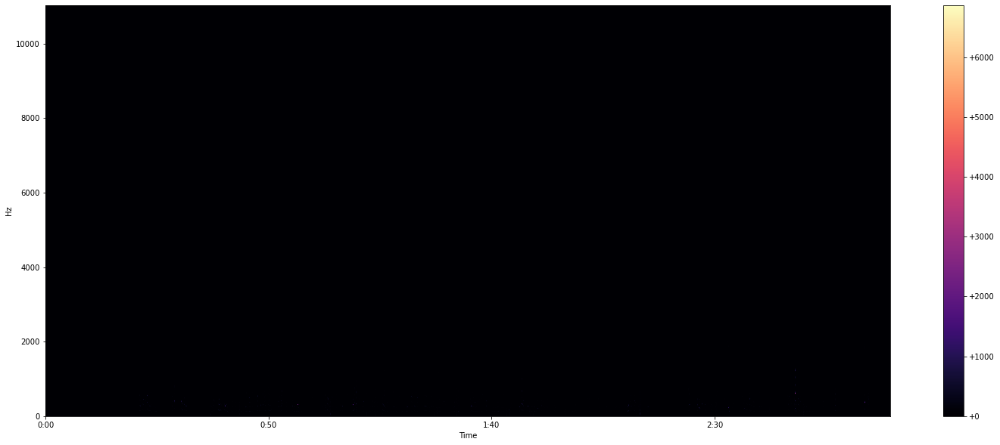

In [14]:
plot_spectrogram(Y_scale, sr, HOP_SIZE)

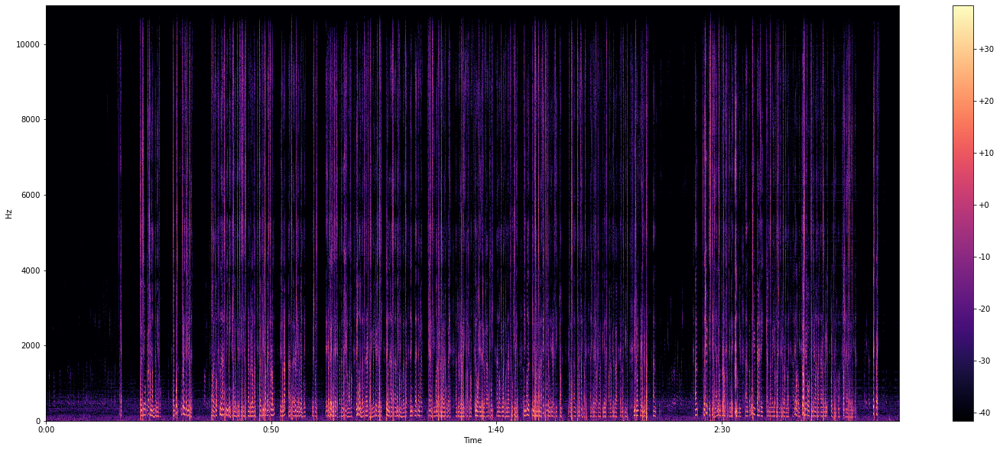

In [15]:
Y_log_scale = librosa.power_to_db(Y_scale)  #Log-Amplitude Spectrogram
plot_spectrogram(Y_log_scale, sr, HOP_SIZE)

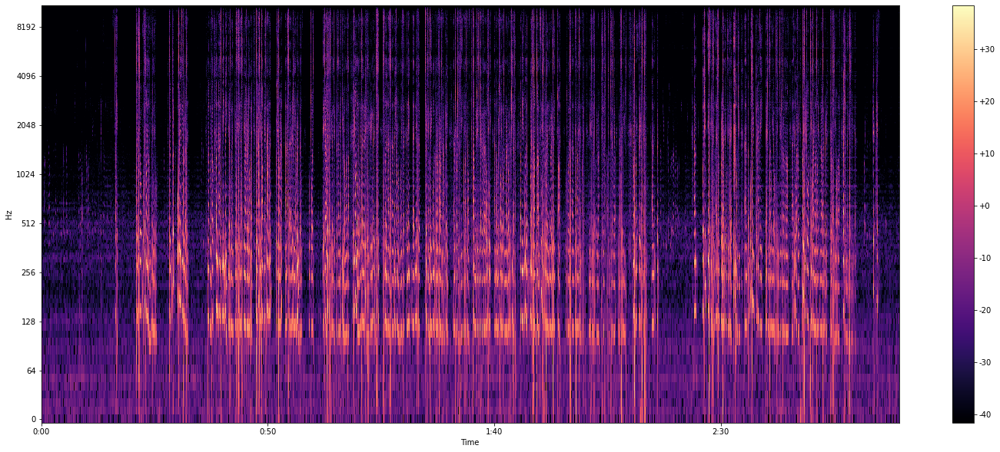

In [16]:
plot_spectrogram(Y_log_scale, sr, HOP_SIZE, y_axis="log") #Log-Frequency Spectrogram

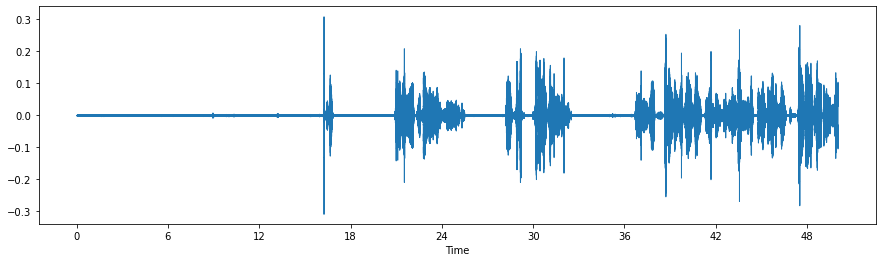

In [25]:
plt.figure(figsize=(15,4))
data1,sample_rate1 = librosa.load(file_path, sr=22050, mono=True, offset=0.0, duration=50, res_type='kaiser_best')
librosa.display.waveshow(data1,sr=sample_rate1, max_points=50000, x_axis='time', offset=0.0)